In [1]:
import os, sys
sys.path.append(os.chdir(os.getcwd()+"/.."))

import numpy as np
import matplotlib
from matplotlib import pyplot as plt
%matplotlib inline

from src.system import system
from src.potential1D import harmonicOsc1D, envelopedPotential
from src.integrator import monteCarloIntegrator, metropolisMonteCarloIntegrator, positionVerletIntegrator
from visualisation.plotSimulations import static_sim_plots
from visualisation.animationSimulation import animation_trajectory


# Plots of Simulations

## Stochastic Integrators

last_state:  State(position=-1.8972117045961454, temperature=298.0, totEnergy=1.7997061260283058, totPotEnergy=1.7997061260283058, totKinEnergy=0, dhdpos=-7.32, velocity=None)
Trajectory length:  250


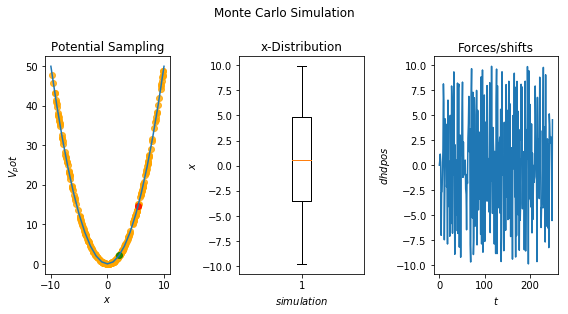

In [2]:
#Simple Monte Carlo simulation:
#settings
sim_steps = 250
x_min, x_max = (-10, 10)
max_step_size = 2.0
pot=harmonicOsc1D()
integrator = monteCarloIntegrator(spaceRange=[x_min, x_max])#maxStepSize=max_step_size,
sys=system(potential=pot, integrator=integrator)

#simulate
cur_state = sys.simulate(sim_steps, withdrawTraj=True)
print("last_state: ", cur_state)
print("Trajectory length: ",len(sys.trajectory))

#plot
static_sim_plots(sys, title="Monte Carlo Simulation", x_range=range(-10,11))

last_state:  State(position=-0.8143208027211712, temperature=298.0, totEnergy=3.3155918487222635, totPotEnergy=3.3155918487222635, totKinEnergy=0, dhdpos=-0.6046570410239459, velocity=None)
250


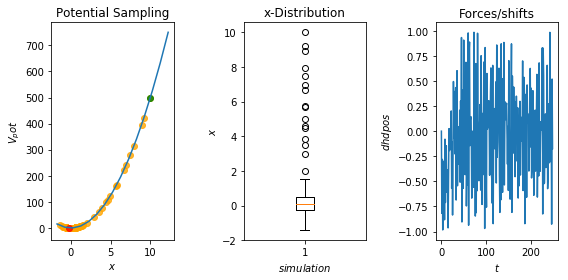

In [3]:
#Simple metropolis Monte Carlo simulation
#settings
sim_steps=250
#criterion= lambda ene_new, currentState: (ene_new < currentState.totPotEnergy)
pot=harmonicOsc1D(fc=10)
integrator = metropolisMonteCarloIntegrator()# metropolisCriterion=criterion (spaceRange=[min(x2), max(x2)], maxStepSize=max_step_size,
sys=system(potential=pot, integrator=integrator,  position=10)

#simulate
cur_state = sys.simulate(steps=sim_steps, withdrawTraj=True)
print("last_state: ", cur_state)
print(len(sys.trajectory))

#plot
static_sim_plots(sys, )

## Newtonian Integrator

Progress: 	0%	10%	20%	30%	40%	50%	60%	70%	80%	90%	100%
init_state State(position=-10, temperature=298.0, totEnergy=50.0, totPotEnergy=50.0, totKinEnergy=0.0, dhdpos=0, velocity=0) 

last_state:  State(position=0.0, temperature=298.0, totEnergy=0.0, totPotEnergy=0.0, totKinEnergy=0.0, dhdpos=0.0, velocity=0.0) 

Trajectory length:  2500


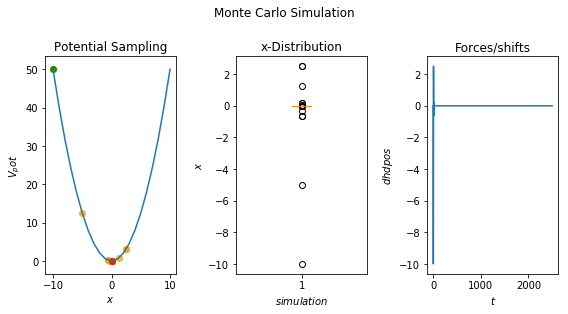

In [19]:
#Simple Verlet integration simulation:
#UNDER DEVELOPMENT!
# The temperature is not constant!!!
#settings
sim_steps = 2500
x_min, x_max = (-10, 10)
max_step_size = 2.0
pot=harmonicOsc1D()
integrator = positionVerletIntegrator(dt=1)#maxStepSize=max_step_size,
sys=system(potential=pot, integrator=integrator, position=-10)
#simulate
cur_state = sys.simulate(sim_steps, withdrawTraj=True, initSystem=True)
print("init_state", sys.trajectory[0], "\n")
print("last_state: ",  sys.trajectory[-1], "\n")
print("Trajectory length: ",len(sys.trajectory))

#plot
static_sim_plots(sys, title="Monte Carlo Simulation", x_range=range(-10,11))

# Animations of Simulations

## Stochastic Integrators

last_state:  State(position=-1.6199999999999988, temperature=298.0, totEnergy=13.12199999999998, totPotEnergy=13.12199999999998, totKinEnergy=0, dhdpos=1.3900000000000001, velocity=None)
200


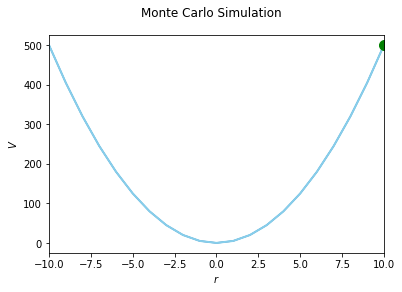

In [2]:
#super Metropolis Monte Carlo Simulation:
#settings
sim_steps = 200
space_range = [-10, 10]
pot=harmonicOsc1D(fc=10)
integrator = monteCarloIntegrator(spaceRange=space_range) #, maxStepSize=max_step_size,
sys=system(potential=pot, integrator=integrator,  position=10)

#simulate
cur_state = sys.simulate(sim_steps, withdrawTraj=True)
print("last_state: ", cur_state)
print(len(sys.trajectory))

#plot
ani, out_path = animation_trajectory(sys, x_range=space_range, title="Monte Carlo Simulation")

import tempfile
os.chdir(tempfile.gettempdir())
from IPython.display import HTML
HTML(ani.to_jshtml())


last_state:  State(position=0.3968530817541126, temperature=298.0, totEnergy=0.7874618424886819, totPotEnergy=0.7874618424886819, totKinEnergy=0, dhdpos=-0.35009300257683695, velocity=None)
250


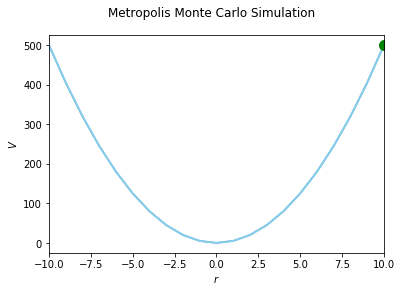

In [3]:
#super easy Metropolis_MonteCarlo simulation
#settings
space_range = [-10, 10]
sim_steps=250
pot=harmonicOsc1D(fc=10)
integrator = metropolisMonteCarloIntegrator(randomnessIncreaseFactor=5) 
sys=system(potential=pot, integrator=integrator,  position=10)

#simulate
cur_state = sys.simulate(sim_steps, withdrawTraj=True) #500000, withdrawTraj=True)
print("last_state: ", cur_state)
print(len(sys.trajectory))


#plot
ani, out_path = animation_trajectory(sys, x_range=space_range, title="Metropolis Monte Carlo Simulation")

##put it into jupyter:
import tempfile
os.chdir(tempfile.gettempdir())
from IPython.display import HTML
HTML(ani.to_jshtml())


last_state:  State(position=-9.640198059811333, temperature=298.0, totEnergy=-98.7054256383647, totPotEnergy=-98.7054256383647, totKinEnergy=0, dhdpos=0.8774059232678448, velocity=None)
160


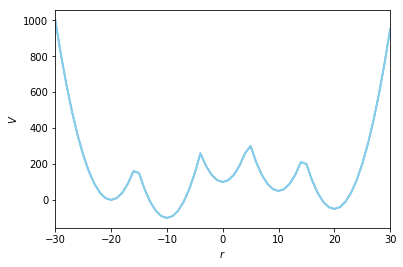

In [8]:
#Metropolis Monte Carlo Simulation for EDS
##Construct potential
s1=1.0
s2=0.0001
Eoffs=(0, 50, -50, 100, -100)
positions = [x / float(10) for x in range(-300, 301)]
fc=20
V_is=[harmonicOsc1D(x_shift=-20, fc=fc), harmonicOsc1D(x_shift=20, fc=fc),
      harmonicOsc1D(x_shift=10, fc=fc), harmonicOsc1D(x_shift=-10, fc=fc), harmonicOsc1D(x_shift=0, fc=fc)]
eds_pot = envelopedPotential(V_is=V_is, s=s2, Eoff_i=Eoffs)

#Build System
integrator = metropolisMonteCarloIntegrator() 
sys=system(potential=eds_pot, integrator=integrator) #,  position=20)
del sys.trajectory[:]


#simulate
svals = [1.0, 0.1, 0.001,  0.001,  0.001,  0.001, 0.1, 1.0]
for s in svals:
    sys.potential.s = s
    cur_state = sys.simulate(20, withdrawTraj=False)
print("last_state: ", cur_state)
print(len(sys.trajectory))


#animation
ani, out_path = animation_trajectory(sys, [min(positions),max(positions)])

import tempfile
os.chdir(tempfile.gettempdir())
from IPython.display import HTML
HTML(ani.to_jshtml())


init_state State(position=-7.5, temperature=298.0, totEnergy=28.125, totPotEnergy=28.125, totKinEnergy=0.0, dhdpos=0, velocity=0) 

last_state:  State(position=-5.9164567891575885e-30, temperature=298.0, totEnergy=3.500446093796892e-59, totPotEnergy=1.750223046898446e-59, totKinEnergy=1.750223046898446e-59, dhdpos=0.0, velocity=-5.9164567891575885e-30) 

Trajectory length:  200


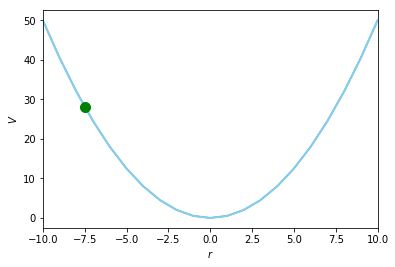

In [9]:
#Simple Verlet integration simulation:
#UNDER DEVELOPMENT!The temperature is not constant!!!
#settings
sim_steps = 200
x_min, x_max = (-10, 10)
max_step_size = 2.0
pot=harmonicOsc1D()
integrator = positionVerletIntegrator(dt=1)#maxStepSize=max_step_size,
sys=system(potential=pot, integrator=integrator, position=-7.5)
#simulate
cur_state = sys.simulate(sim_steps, withdrawTraj=True, initSystem=True)
print("init_state", sys.trajectory[0], "\n")
print("last_state: ",  sys.trajectory[-1], "\n")
print("Trajectory length: ",len(sys.trajectory))

#animation
ani, out_path = animation_trajectory(sys, [x_min, x_max])

import tempfile
os.chdir(tempfile.gettempdir())
from IPython.display import HTML
HTML(ani.to_jshtml())